In [ ]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
from IPython.display import display, HTML
from ipywidgets import interact, FloatSlider, IntSlider, Button, Output 
display(HTML("<style>.rendered_html.text_cell_render {max-width:600px; }</style>")) 

In [ ]:
#nbx

#ximp
import matplotlib.pyplot as plt
from IPython.display import Audio, display
plot = plt.plot

In [ ]:
#nbx
#ximp
import warnings
warnings.filterwarnings("ignore")
#ximp
import torch
import numpy as np
from cgnai.utils import cgnai_home, sliding_window_ind
from cgnai.fileio import load, dump, ls
import torchaudio
import librosa
from pathlib import Path
from cgnai.audio.utils import compute_embedding

In [ ]:
#nbx
#ximp
import numpy as np
from pyannote.audio import Pipeline
from pyannote.audio import Inference

In [ ]:


seg_pipe = Pipeline.from_pretrained("pyannote/speaker-segmentation")

def compute_segs(w,sr):
    res  = seg_pipe({"waveform": w[[0]], "sample_rate": sr})
    segs = res.get_timeline().segments_list_
    return np.array([(round(s.start * sr), round(s.end*sr)) for s in segs])

va_pipe = Pipeline.from_pretrained("pyannote/voice-activity-detection")

def compute_va(w, sr):
    """Voice Activity."""
    res = va_pipe({"waveform": w[[0]], "sample_rate": sr})
    return np.array([(round(x.start*sr), round(x.end*sr)) for x in res._tracks.keys()])

In [ ]:
#nbx
#xargs
xdir  = Path("./")
xtask = 0 

In [ ]:
#nbx
path = cgnai_home()/"shared/podverse/data/politik_podcast"
is_mp3 = lambda s: s.endswith(".mp3")

fnames = list(filter(is_mp3, ls(path).files))
len(fnames)

19

In [ ]:
#nbx

#xarg
j = 0; range(19)

fname = fnames[j]
torchaudio.set_audio_backend("sox_io") # Can't load mp3 otherwise on my Macbook
wav, sr =  torchaudio.load(str(path/fname))

# --------------
print(fname)
print(wav.size())

der_politikpodcast_folge_251_runter_vom_russischen_gas_dlf_20220401_0137_4e4932d6.mp3
torch.Size([2, 119966976])


In [ ]:
#nbx
#xarg
dur  = 2.0; [4.0] # cut width for the embeddings 

step = min(dur, 1.0)

emb = Inference("pyannote/embedding", window="sliding", duration=dur, step=step)

In [ ]:
#nbx
x = emb({"waveform":wav[[0]], "sample_rate": sr})
x = x.data

print("x.shape: ", x.shape)
dump(x, str(xdir/"emb.pkl")) ####

x.shape:  (2720, 512)


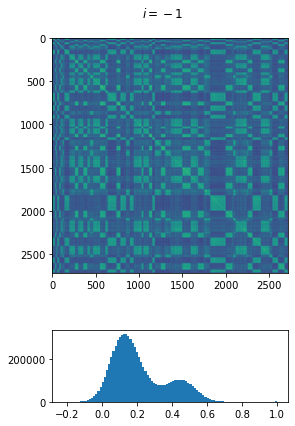

In [ ]:
#nbx
x = x/np.linalg.norm(x, axis=1, keepdims=True)
D = x@x.T
# ----------------------------
fig, axs = plt.subplot_mosaic([[0],[1]], 
                          sharey=False,
                          gridspec_kw = dict(width_ratios=[1], height_ratios=[4,1]),
                          figsize=(4, 6), layout="constrained")
fig.tight_layout()
fig.suptitle(f"$i = {xtask-1}$")
axs[0].imshow(D);
axs[1].hist(D.flatten(), bins=100);
plt.savefig(xdir/"summary.jpg", bbox_inches='tight', dpi=100) ####

In [ ]:
#nbx
dump(D, xdir/f"D.npy")

# NBX

In [ ]:
from cgnai.nbx import create_bundle
create_bundle("_nbx_distances")

Creating bundle:

	_nbx_distances/experiment
	_nbx_distances/confspace.json (#confs = 19)
	_nbx_distances/wrapper.py
	_nbx_distances/runner.sh



# Analysis

In [ ]:
from pathlib import Path
import numpy as np
from cgnai.fileio import load
import matplotlib.pyplot as plt
from IPython.display import Audio, display
plot = plt.plot

In [ ]:
data_path = Path("_nbx_distances/results")
Ds = []
for i in range(19):
    D = load(data_path/f"{i}"/"D.npy")
    Ds.append(D)

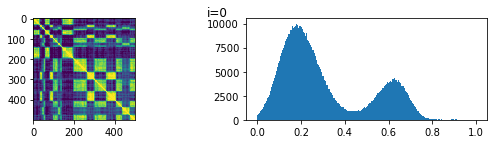

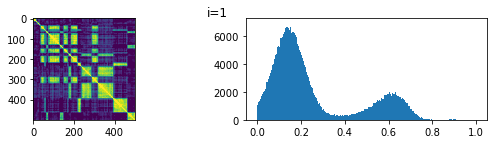

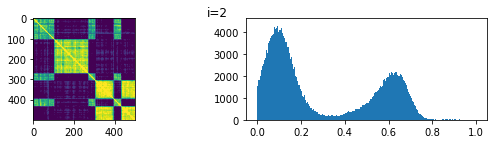

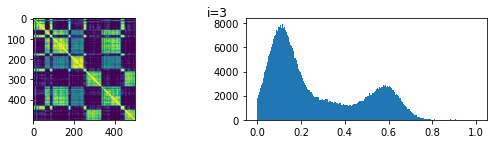

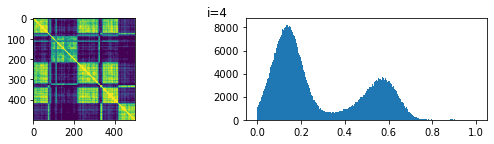

...

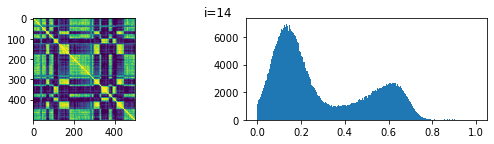

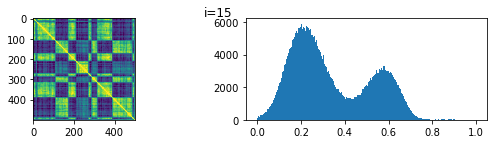

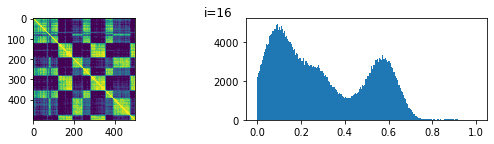

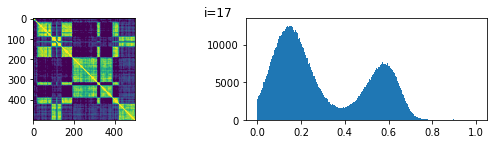

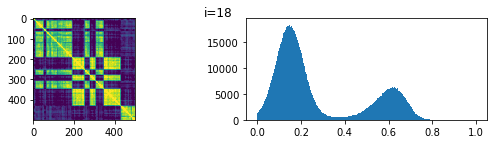

In [ ]:
for i,D in enumerate(Ds):
    fig, axs = plt.subplots(1, 2, figsize=(8,2)); 
    fig.tight_layout();
    fig.suptitle(f"i={i}")
    axs[0].imshow(D[:500,:500], vmin=0.1, vmax=0.7)
    axs[1].hist(D.flatten(), bins=np.linspace(0,1,2_500))

In [ ]:
i = 16
D = Ds[i]
print(D.shape)


(2200, 2200)


In [ ]:

fname = fnames[i]
torchaudio.set_audio_backend("sox_io") # Can't load mp3 otherwise on my Macbook
wav, sr =  torchaudio.load(str(path/fname))
wav.shape[1]//sr

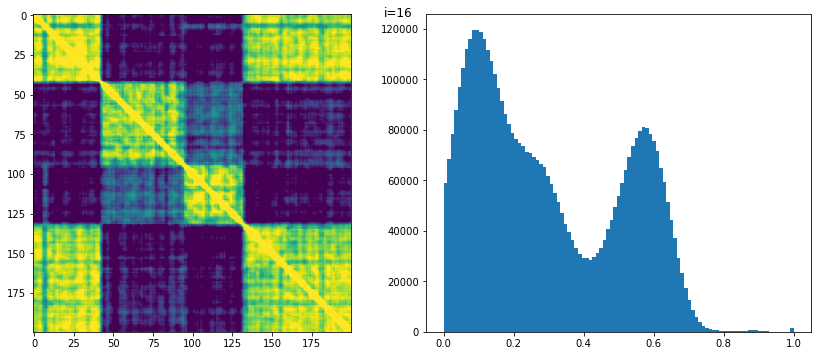

In [ ]:
t0 = 150
t1 = t0 + 200
# -----------
fig, axs = plt.subplots(1, 2, figsize=(12,5)); 
fig.tight_layout();
fig.suptitle(f"i={i}")
axs[0].imshow(D[t0:t1,t0:t1], vmin=0.1, vmax=0.7);
axs[1].hist(D.flatten(), bins=np.linspace(0,1,100));

In [ ]:
display(Audio(wav[1,t0*sr:t1*sr], rate=sr))

## Gaussian mixtures 

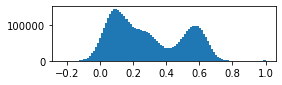

In [ ]:
from scipy.stats import norm
from sklearn.mixture import GaussianMixture

data_path = Path("_nbx_distances/results")

i = 16
D = load(data_path/f"{i}"/"D.npy")
data = D.flatten()[:,None]

# -----------------
plt.figure(figsize=(4,1));
plt.hist(data, bins=100);

In [ ]:
gm2 = GaussianMixture(n_components=2, random_state=0).fit(data)
gm3 = GaussianMi

0.2818747906020789

In [ ]:
summary = """
{gm}:

    mu      = {means}, 
    var     = {covs}

    weights = {ws}
    
    score   = {sc} 
"""

def get_mix(gm):
    order = np.argsort(gm.means_[:,0])
    means = gm.means_[order,0]
    covs  = gm.covariances_[order,0,0]
    ws = gm.weights_[order]
    sc = gm.score(data)
    return means, covs, ws, sc

def show_stats(gms):
    for gm in gms:
        means, covs, ws, sc = get_mix(gm)
        print(summary.format(gm=gm, means=means, covs=covs, ws=ws,sc=sc))

show_stats([gm2, gm3])


GaussianMixture(n_components=2, random_state=0):

    mu      = [0.14707974 0.54099925], 
    var     = [0.01127224 0.00944595]

    weights = [0.64485388 0.35514612]
    
    score   = 0.2818747906020789 


GaussianMixture(n_components=3, random_state=0):

    mu      = [0.08731311 0.27113818 0.56123564], 
    var     = [0.00476652 0.00599619 0.00635187]

    weights = [0.41573538 0.26622279 0.31804184]
    
    score   = 0.3074375560982684 



0.597719043839558
0.6300216812336576


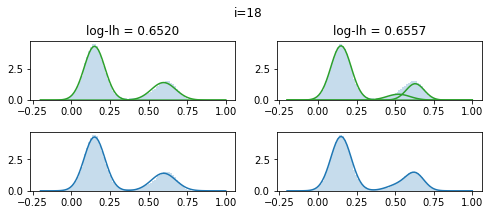

In [ ]:
x    = np.linspace(-0.2,1,100)
bins = x - (x[1] - x[0])/2
    
def show_hist(i, gms, data):
    fig, axs = plt.subplots(2,len(gms), figsize=(7,3))
    fig.suptitle(f"i={i}")
    fig.tight_layout()
    for g,gm in enumerate(gms):
        means, covs, ws, sc = get_mix(gm)
        axs[0,g].hist(data, bins=bins, density=True, color="C0", alpha=0.25);
        axs[1,g].hist(data, bins=bins, density=True, color="C0", alpha=0.25);
        for mu,var,w in zip(means, covs, ws):
            axs[0,g].set_title(f"log-lh = {sc:0.4f}")
            axs[0,g].plot(x, w*norm.pdf(x, loc=mu, scale=var**0.5), c="C2")
            
        axs[1,g].plot(x, sum([w*norm.pdf(x, loc=mu, scale=var**0.5) 
                            for mu,var,w in zip(means, covs, ws)]), c="C0")
        print(means[-1])
            
show_hist(i,[gm2,gm3], data)

### All histograms with Gaussians mixtures

0.6062991579649113
0.6075777623541184
0.5901649458636663
0.5877048677529586
0.5944454055484443
0.6206772847415761
0.5297552708609867
0.5701528127702069
0.5485571235106951
0.5810171085603786
0.6079525141988218
0.607869504522268
0.5498131491537654
0.5492634494472248
0.5519236912232465
0.5649621062189125
0.5251389450086994
0.5257823722635602
0.541985383054067
0.552762048033752
0.5466466811577897
0.5565840316081134
0.5469066523767032
0.5461830569977397
0.5780300600059521
0.5750779936473875
0.6229703628379368
0.627024573723298
0.5611727135470352
0.5761073507386714
0.5582162280464975
0.563635405837482
0.5409992482993338
0.5612356354284053
0.5597879442096111
0.5612117286199603
0.597719043839558
0.6300216812336576


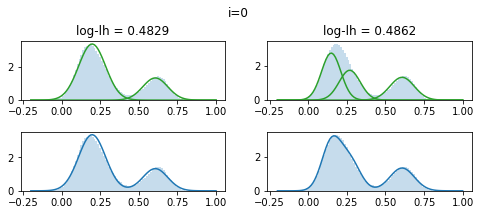

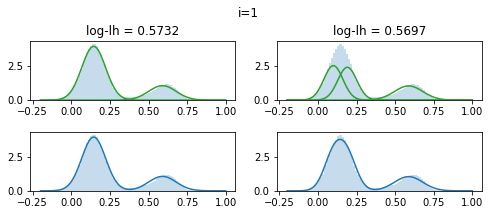

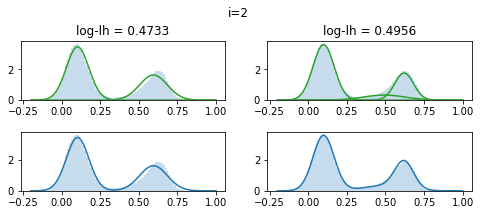

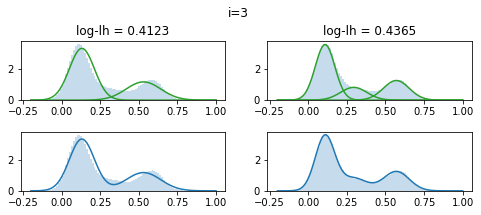

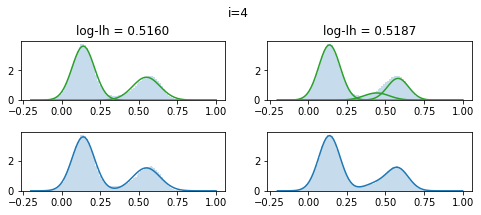

...

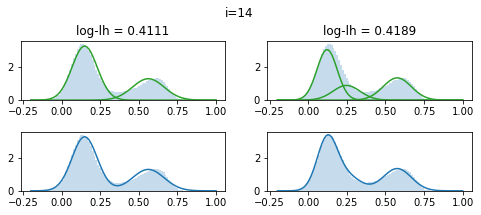

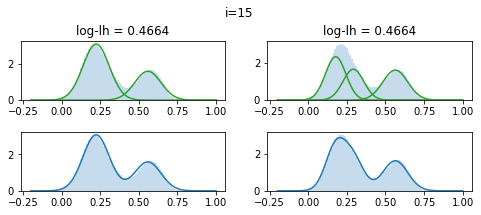

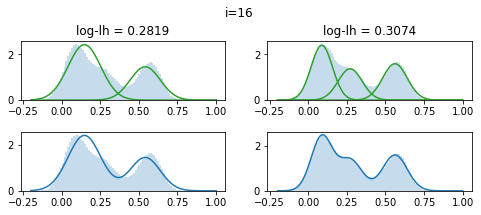

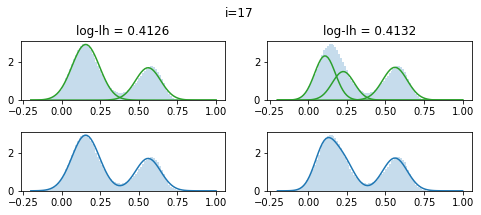

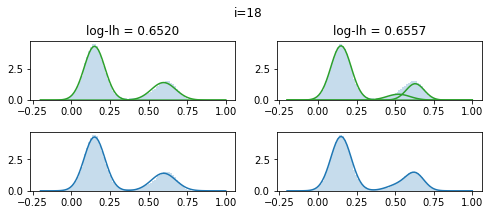

In [ ]:
for i in range(19):
    D = load(data_path/f"{i}"/"D.npy")
    data = D.flatten()[:,None]
    gm2 = GaussianMixture(n_components=2, random_state=0).fit(data)
    gm3 = GaussianMixture(n_components=3, random_state=0).fit(data)
    gms = [gm2,gm3]
    show_hist(i,gms, data)